In [1]:
import numpy as np
import pylab
import pandas as pd
import matplotlib.pyplot as plt

triads = [['BPS'+str(i),'BPS'+str(i+20),'BPS'+str(i+40)] for i in range(1,21)]
pd.options.display.max_columns= 79

# C1 Data/ Visualization

In [2]:
df = pd.read_csv('validation/BPS_C1_16-17MAY.csv')

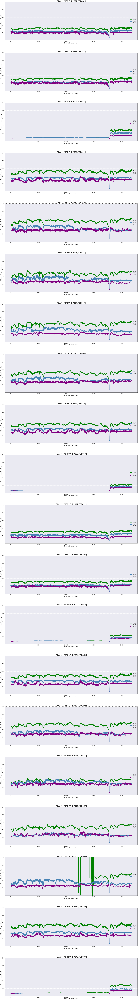

In [3]:
plt.style.use("seaborn")
fig, axs = plt.subplots(20, figsize=(30, 200))
colors= ['green', 'steelblue', 'purple']
l_width=[5,7,5]
l_style=['solid', 'solid', 'dashed']

for i in range(20):
    for j in range(3):
        axs[i].plot(df[triads[i][j]],label=triads[i][j], linewidth=l_width[j], color=colors[j], linestyle=l_style[j])
        
        axs[i].set_title('Triad '+ str(i+1)+ ': ' + str(triads[i]), fontsize=26, fontweight="bold")
        axs[i].set_ylabel('Thermo Couple Reading', fontsize=20)
        axs[i].set_xlabel('Time instance of Slabs', fontsize=20)
        axs[i].tick_params(axis='both', labelsize=18)
        axs[i].patch.set_edgecolor('black')
        axs[i].patch.set_linewidth('1')
        axs[i].legend(fontsize=16, loc='center right')
        axs[i].grid(axis = 'both', linestyle='--')
        axs[i].set_ylim(0,500)
        

plt.tight_layout(pad=10)
plt.legend()
plt.show()

# Np.roll method

In [4]:
c_result=[]
funnel = []
for curr in triads[0:20]:
    
    input1 = df[curr[0]].to_numpy()
    input2 = df[curr[1]].to_numpy()
    input3 = df[curr[2]].to_numpy()
    
    input4= np.array([input1, input2,input3]).sum(axis=0)
    
    num=len(input1)
    
    sens=2.5
    band=4
    
    t1= (sens/100)*np.mean(input1)
    t2= (sens/100)*np.mean(input2)
    t3= (sens/100)*np.mean(input3)
    
    signal1 =  ((np.roll(input1,band) - input1 > t1) | (np.roll(input1,band+1) - input1 > t1))  & (np.roll(input1,-band) - input1 > t1)
    signal2 = ((np.roll(input2,band) - input2 > t2) | (np.roll(input2,band+1) - input1 > t1)) & (np.roll(input2,-band) - input2 > t2)
    signal3 = ((np.roll(input3,band) - input3 > t3) | (np.roll(input3,band+1) - input1 > t1)) & (np.roll(input3,-band) - input3 > t3)
    
    
    
    
    sig_1=[]
    sig_2=[]
    sig_3=[]

    for i in range(len(signal1)):
        if signal1[i] == True:
            sig_1.append(i)
        
    for i in range(len(signal2)):
        if signal2[i] == True:
            sig_2.append(i)

    for i in range(len(signal3)):
        if signal3[i] == True:
            sig_3.append(i)
            
    common=[]
    
    for i in sig_1:
        if ((i+1) in sig_2 or i in sig_2 or (i-1) in sig_2) and ((i+1) in sig_3 or i in sig_3 or (i-1) in sig_3):
            common.append(i)

    for i in common:
        flag=True
        n=1
        while(flag):
            if (i+n) in common:
                common.remove(i+n)
                n=n+1
            else:
                flag=False
            
    c_result.append(common)
    funnel.append(len(common))
    
    print(curr[0] + ' + ' + curr[1] + ' + ' + curr[2] + ' = ' + str(common)+ '\n\n')

BPS1 + BPS21 + BPS41 = [16096, 17010, 17630, 20395, 20996, 21148, 21457, 22012, 22079, 22293, 22484, 24452, 27815, 30088, 32518, 33150, 33491, 34135, 34333, 36440, 36483, 36576, 37749, 40424]


BPS2 + BPS22 + BPS42 = [2591, 14758, 17010, 20064, 20996, 21367, 22485, 37607, 39963, 42281, 43660]


BPS3 + BPS23 + BPS43 = [36022, 36254, 36575, 36675, 36732, 37441, 37613, 37728, 38111, 38135, 38241, 38310, 38397, 38488, 38499, 38774, 39602, 39757, 40121, 40194, 40205, 40494, 40530, 40628, 40805, 40883, 41312, 41924, 42116, 42242, 42282, 43157, 43177, 43196, 43244, 43472, 43485, 43564, 43660]


BPS4 + BPS24 + BPS44 = []


BPS5 + BPS25 + BPS45 = []


BPS6 + BPS26 + BPS46 = [19479]


BPS7 + BPS27 + BPS47 = [319]


BPS8 + BPS28 + BPS48 = []


BPS9 + BPS29 + BPS49 = []


BPS10 + BPS30 + BPS50 = [36032, 36077, 36379, 37652, 37916, 38003, 38112, 38267, 38997, 39123, 39137, 39157, 39809, 40462, 40655, 40881, 41027, 42199, 42260, 42377, 42468, 42690, 43054, 43633, 43679]


BPS11 + BPS31 + BPS51 = [24

In [6]:
#dip points

df_val1=pd.DataFrame(columns=['Index','Time','Met_length','Triad', 'Type', 'Algo'])
counter=0
for i in range(len(c_result)):
    for j in range(len(c_result[i])):
        result=(c_result[i][j])
        df_val1.loc[counter]=pd.Series({'Index':result, 'Time':df.iloc[result]['TIME_STAMP'], 'Met_length':str(df.iloc[result]['MET_LENGTH']), 'Triad':triads[i], 'Type':'Narrow','Algo': 'Np.roll'})
        counter=counter+1
        

c1_narrow=df_val1.sort_values(by='Index', ascending=False)
print('-'*100)
print(' '*15+ 'C1 Narrow dips through Np.roll [Dips Registered: '+str(len(c1_narrow))+']')
print('-'*100)
c1_narrow

----------------------------------------------------------------------------------------------------
               C1 Narrow dips through Np.roll [Dips Registered: 127]
----------------------------------------------------------------------------------------------------


,Index,Time,Met_length,Triad,Type,Algo
100,43679,16-05-22 18:30:18,7246.104,"[BPS10, BPS30, BPS50]",Narrow,Np.roll
34,43660,16-05-22 18:30:55,7266.692,"[BPS2, BPS22, BPS42]",Narrow,Np.roll
73,43660,16-05-22 18:30:55,7266.692,"[BPS3, BPS23, BPS43]",Narrow,Np.roll
99,43633,16-05-22 18:31:47,7266.183,"[BPS10, BPS30, BPS50]",Narrow,Np.roll
72,43564,16-05-22 18:33:57,7250.62,"[BPS3, BPS23, BPS43]",Narrow,Np.roll
...,...,...,...,...,...,...
121,4235,17-05-22 16:14:41,7093.813,"[BPS17, BPS37, BPS57]",Narrow,Np.roll
24,2591,17-05-22 17:07:23,5425.3,"[BPS2, BPS22, BPS42]",Narrow,Np.roll
101,2419,17-05-22 17:12:51,5425.3,"[BPS11, BPS31, BPS51]",Narrow,Np.roll
108,1111,17-05-22 17:54:36,6864.704,"[BPS12, BPS32, BPS52]",Narrow,Np.roll


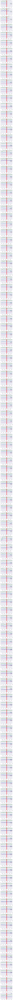

In [7]:
#plotting detected dips
plt.style.use("seaborn")

fig, axs = plt.subplots(len(c1_narrow), figsize=(10, 7*len(c1_narrow)))
for i in range(len(c1_narrow)):
    Title= str('Time:'+c1_narrow.iloc[i]['Time'])+'     Met_Length:'+str(c1_narrow.iloc[i]['Met_length'])+'    Triad: '+str(c1_narrow.iloc[i]['Triad'])
    det= int(c1_narrow.iloc[i]['Index'])
    tr= c1_narrow.iloc[i]['Triad']
    
    colors= ['green', 'steelblue', 'purple']
    l_width=[5,7,5]
    l_style=['solid', 'solid', 'dashed']
    for j in range(3):
        axs[i].plot(df[tr[j]],label=tr[j], linewidth=l_width[j], color=colors[j], linestyle=l_style[j])
    axs[i].axvspan(det-2,det+3, facecolor='r', alpha=0.5)
    axs[i].set_title(Title)
    axs[i].tick_params(axis='both', labelsize=18)
    
    axs[i].legend(fontsize=16, loc='center right')
    axs[i].grid(axis = 'both', linestyle='--')
    axs[i].set_xlim(det-50,det+50)
plt.legend()
plt.show()

# C2 Data

In [8]:
df = pd.read_csv('validation/BPS_C2_16-17MAY.csv')

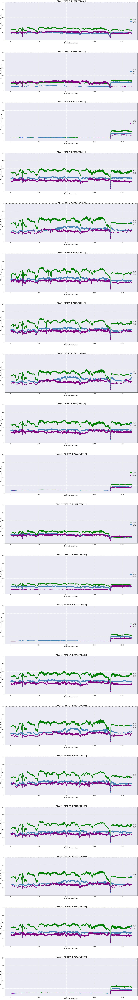

In [9]:
plt.style.use("seaborn")
fig, axs = plt.subplots(20, figsize=(30, 200))
colors= ['green', 'steelblue', 'purple']
l_width=[5,7,5]
l_style=['solid', 'solid', 'dashed']

for i in range(20):
    for j in range(3):
        axs[i].plot(df[triads[i][j]],label=triads[i][j], linewidth=l_width[j], color=colors[j], linestyle=l_style[j])
        
        axs[i].set_title('Triad '+ str(i+1)+ ': ' + str(triads[i]), fontsize=26, fontweight="bold")
        axs[i].set_ylabel('Thermo Couple Reading', fontsize=20)
        axs[i].set_xlabel('Time instance of Slabs', fontsize=20)
        axs[i].tick_params(axis='both', labelsize=18)
        axs[i].patch.set_edgecolor('black')
        axs[i].patch.set_linewidth('1')
        axs[i].legend(fontsize=16, loc='center right')
        axs[i].grid(axis = 'both', linestyle='--')
        axs[i].set_ylim(0,500)
        

plt.tight_layout(pad=10)
plt.legend()
plt.show()

In [10]:
c_result=[]
funnel = []
for curr in triads[0:20]:
    
    input1 = df[curr[0]].to_numpy()
    input2 = df[curr[1]].to_numpy()
    input3 = df[curr[2]].to_numpy()
    
    input4= np.array([input1, input2,input3]).sum(axis=0)
    
    num=len(input1)
    
    sens=2.5
    band=3
    
    t1= (sens/100)*np.mean(input1)
    t2= (sens/100)*np.mean(input2)
    t3= (sens/100)*np.mean(input3)
    
    signal1 =  ((np.roll(input1,band) - input1 > t1) | (np.roll(input1,band+1) - input1 > t1))  & (np.roll(input1,-band) - input1 > t1)
    signal2 = ((np.roll(input2,band) - input2 > t2) | (np.roll(input2,band+1) - input1 > t1)) & (np.roll(input2,-band) - input2 > t2)
    signal3 = ((np.roll(input3,band) - input3 > t3) | (np.roll(input3,band+1) - input1 > t1)) & (np.roll(input3,-band) - input3 > t3)
    
    sig_1=[]
    sig_2=[]
    sig_3=[]

    for i in range(len(signal1)):
        if signal1[i] == True:
            sig_1.append(i)
        
    for i in range(len(signal2)):
        if signal2[i] == True:
            sig_2.append(i)

    for i in range(len(signal3)):
        if signal3[i] == True:
            sig_3.append(i)
            
    common=[]
    
    for i in sig_1:
        if ((i+1) in sig_2 or i in sig_2 or (i-1) in sig_2) and ((i+1) in sig_3 or i in sig_3 or (i-1) in sig_3):
            common.append(i)

    for i in common:
        flag=True
        n=1
        while(flag):
            if (i+n) in common:
                common.remove(i+n)
                n=n+1
            else:
                flag=False
            
    c_result.append(common)
    funnel.append(len(common))
    
    print(curr[0] + ' + ' + curr[1] + ' + ' + curr[2] + ' = ' + str(common)+ '\n\n')

BPS1 + BPS21 + BPS41 = [4172, 28803, 29719, 31261, 32836, 32889, 33216, 33242, 41817]


BPS2 + BPS22 + BPS42 = [4173]


BPS3 + BPS23 + BPS43 = [36063, 39775, 42208, 42339]


BPS4 + BPS24 + BPS44 = []


BPS5 + BPS25 + BPS45 = []


BPS6 + BPS26 + BPS46 = [1477, 4185, 5929, 6160, 6176, 13375, 13436, 13487, 14464]


BPS7 + BPS27 + BPS47 = [18, 23092]


BPS8 + BPS28 + BPS48 = []


BPS9 + BPS29 + BPS49 = [12371, 23203, 29723]


BPS10 + BPS30 + BPS50 = [40721]


BPS11 + BPS31 + BPS51 = [3095, 3109, 3137, 3391, 3403, 4172, 6717, 7542, 8159, 8348, 11120, 11152, 11244, 11256, 11333, 11390, 11556, 11628, 11841, 13029, 13195, 13319, 13345, 13462, 13657, 14228, 14780, 14872, 15453, 15711, 15971, 17914, 18154, 18210, 18560, 19272, 21418, 22721, 23634, 23707, 25751, 26027, 26103, 26134, 28050, 28470, 28640, 29503, 29516, 29524, 29536, 29542, 29722, 29768, 29946, 30062, 30121, 30317, 30405, 30532, 30579, 30686, 31177, 31424, 31617, 31625, 31904, 32002, 32312, 32329, 32490, 33211, 33253, 33640, 35252, 

In [11]:
#dip points

df_val2=pd.DataFrame(columns=['Index','Time','Met_length','Triad', 'Type', 'Algo'])
counter=0
for i in range(len(c_result)):
    for j in range(len(c_result[i])):
        result=(c_result[i][j])
        df_val2.loc[counter]=pd.Series({'Index':result, 'Time':df.iloc[result]['TIME_STAMP'], 'Met_length':str(df.iloc[result]['MET_LENGTH']), 'Triad':triads[i], 'Type':'Narrow','Algo': 'Np.roll'})
        counter=counter+1
        

c2_narrow=df_val2.sort_values(by='Index', ascending=False)
print('-'*100)
print(' '*15+ 'C2 Narrow dips through Np.roll [Dips Registered: '+str(len(c2_narrow))+']')
print('-'*100)
c2_narrow

----------------------------------------------------------------------------------------------------
               C2 Narrow dips through Np.roll [Dips Registered: 121]
----------------------------------------------------------------------------------------------------


,Index,Time,Met_length,Triad,Type,Algo
13,42339,16-05-22 19:04:43,7497.218,"[BPS3, BPS23, BPS43]",Narrow,Np.roll
12,42208,16-05-22 19:08:54,7496.661,"[BPS3, BPS23, BPS43]",Narrow,Np.roll
120,41818,16-05-22 19:21:21,7488.725,"[BPS20, BPS40, BPS60]",Narrow,Np.roll
8,41817,16-05-22 19:21:23,7488.725,"[BPS1, BPS21, BPS41]",Narrow,Np.roll
119,41764,16-05-22 19:23:04,7499.172,"[BPS20, BPS40, BPS60]",Narrow,Np.roll
...,...,...,...,...,...,...
31,3137,17-05-22 16:53:06,7238.422,"[BPS11, BPS31, BPS51]",Narrow,Np.roll
30,3109,17-05-22 16:54:03,7226.195,"[BPS11, BPS31, BPS51]",Narrow,Np.roll
29,3095,17-05-22 16:54:30,7226.093,"[BPS11, BPS31, BPS51]",Narrow,Np.roll
14,1477,17-05-22 17:46:08,6677.458,"[BPS6, BPS26, BPS46]",Narrow,Np.roll


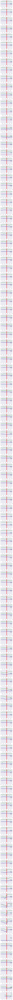

In [12]:
#plotting detected dips
plt.style.use("seaborn")

fig, axs = plt.subplots(len(c2_narrow), figsize=(10, 7*len(c2_narrow)))
for i in range(len(c2_narrow)):
    Title= str('Time:'+c2_narrow.iloc[i]['Time'])+'     Met_Length:'+str(c2_narrow.iloc[i]['Met_length'])+'    Triad: '+str(c2_narrow.iloc[i]['Triad'])
    det= int(c2_narrow.iloc[i]['Index'])
    tr= c2_narrow.iloc[i]['Triad']
    
    colors= ['green', 'steelblue', 'purple']
    l_width=[5,7,5]
    l_style=['solid', 'solid', 'dashed']
    for j in range(3):
        axs[i].plot(df[tr[j]],label=tr[j], linewidth=l_width[j], color=colors[j], linestyle=l_style[j])
    axs[i].axvspan(det-2,det+3, facecolor='r', alpha=0.5)
    axs[i].set_title(Title)
    axs[i].tick_params(axis='both', labelsize=18)
    
    axs[i].legend(fontsize=16, loc='center right')
    axs[i].grid(axis = 'both', linestyle='--')
    axs[i].set_xlim(det-50,det+50)
plt.legend()
plt.show()